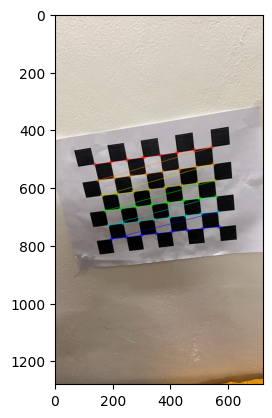

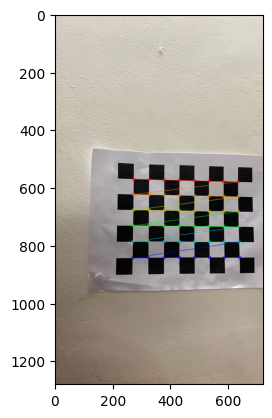

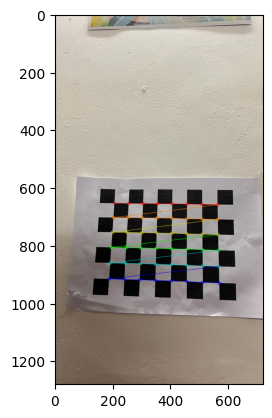

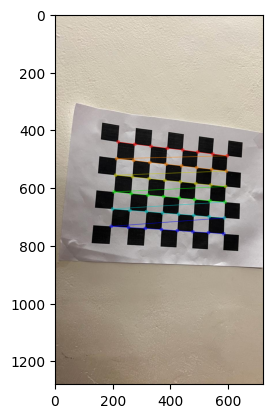

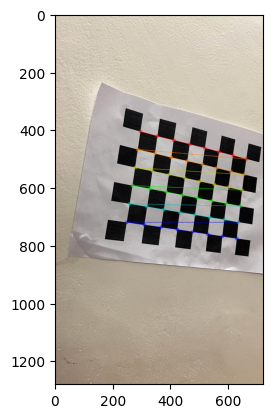

...

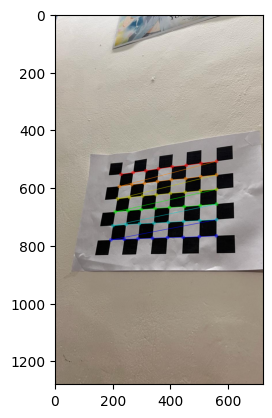

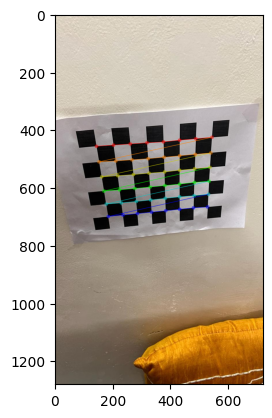

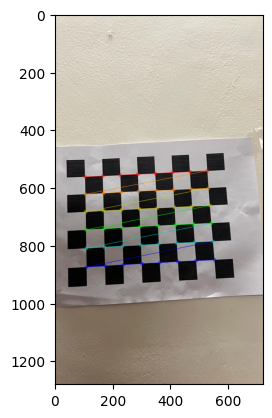

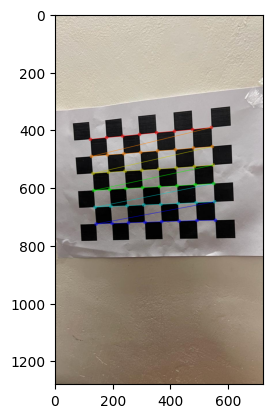

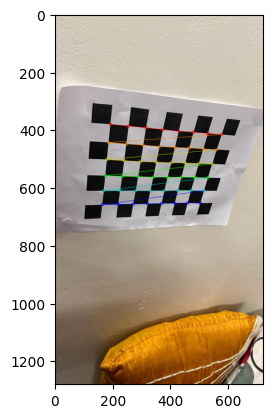

In [35]:
import numpy as np
import matplotlib.pyplot as plt
import os
import cv2
import json

DIR_PATH = r"/kaggle/input/chess-board/chessboard_dataset-20250402T180104Z-001/chessboard_dataset"

image_names = []
my_cnt=0
for name in os.listdir(DIR_PATH):
    if name.lower().endswith(('.png', '.jpg', '.jpeg')):
        image_names.append(os.path.join(DIR_PATH, name))

criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)

objp = np.zeros((8 * 6, 3), np.float32)
objp[:, :2] = np.mgrid[0:8, 0:6].T.reshape(-1, 2)

alpha=0


objpoints = []  
imgpoints = [] 

for image_name in image_names:
    img = cv2.imread(image_name)

    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    ret, corners = cv2.findChessboardCorners(gray, (8, 6), None)
    my_cnt+=1

    objpoints.append(objp)
    corners2 = cv2.cornerSubPix(gray, corners, (11, 11), (-1, -1), criteria)
    imgpoints.append(corners2)

    img = cv2.drawChessboardCorners(img, (8, 6), corners2, ret)
    my_cnt+=1
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    
    plt.show()

cv2.destroyAllWindows()

ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)


In [36]:
fx = mtx[0, 0]
fy = mtx[1, 1]
cx = mtx[0, 2]
ax = mtx[2, 0]
cy = mtx[1, 2]
s =  mtx[0, 1]
qx=mtx[2,2]
print("Camera matrix : \n")
print(mtx)
print("fx = ", fx)
print("fy = ", fy)
print("cx = ", cx)
print("cy = ", cy)
print("s = ", s)

Camera matrix : 

[[956.63719897   0.         369.05485204]
 [  0.         957.55141318 651.41419982]
 [  0.           0.           1.        ]]
fx =  956.637198973105
fy =  957.5514131759558
cx =  369.0548520367341
cy =  651.414199816039
s =  0.0


In [37]:
for i in range(len(objpoints)):
    rotation_matrix, _ = cv2.Rodrigues(rvecs[i])
    print(f'{image_names[i]}:')
    print('Rotation Matrix:')
    print(rotation_matrix)
    print('Translation Vector:')
    print(tvecs[i])
    print()

/kaggle/input/chess-board/chessboard_dataset-20250402T180104Z-001/chessboard_dataset/14.jpeg:
Rotation Matrix:
[[ 0.98785166  0.1486754   0.04521854]
 [-0.12616746  0.93720009 -0.32517343]
 [-0.09072411  0.31551801  0.94457267]]
Translation Vector:
[[-4.04192137]
 [-2.28530083]
 [16.69040481]]

/kaggle/input/chess-board/chessboard_dataset-20250402T180104Z-001/chessboard_dataset/18.jpeg:
Rotation Matrix:
[[ 0.98924679 -0.00715685 -0.14608072]
 [ 0.01812136  0.99710353  0.07386587]
 [ 0.14512895 -0.07571876  0.98651115]]
Translation Vector:
[[-1.80356214]
 [-1.50987191]
 [17.84239918]]

/kaggle/input/chess-board/chessboard_dataset-20250402T180104Z-001/chessboard_dataset/16.jpeg:
Rotation Matrix:
[[ 0.99701095 -0.02798632  0.07201336]
 [ 0.01170725  0.97604928  0.21723429]
 [-0.07636818 -0.21574189  0.97345947]]
Translation Vector:
[[-3.27368209]
 [ 0.04613895]
 [19.13910713]]

/kaggle/input/chess-board/chessboard_dataset-20250402T180104Z-001/chessboard_dataset/25.jpeg:
Rotation Matrix:
[

In [38]:
for i in range(len(objpoints)):
    if image_names[i] == '/kaggle/input/chess-board/chessboard_dataset-20250402T180104Z-001/chessboard_dataset/1.jpeg':
        rotation_matrix1, _ = cv2.Rodrigues(rvecs[i])
        print(f'{image_names[i]}:')
        print('Rotation Matrix:')
        print(rotation_matrix)
        print('Translation Vector:')
        tvex1=tvecs[i]
        print(tvecs[i])
        print()
print(rotation_matrix1)

/kaggle/input/chess-board/chessboard_dataset-20250402T180104Z-001/chessboard_dataset/1.jpeg:
Rotation Matrix:
[[ 0.91736941 -0.19600125 -0.34643452]
 [-0.01803989  0.84899005 -0.5281008 ]
 [ 0.39762788  0.49071316  0.77530166]]
Translation Vector:
[[-3.93829473]
 [-3.61716296]
 [14.65911195]]

[[ 0.99699847  0.01387206 -0.0761683 ]
 [-0.02511535  0.9885627  -0.14870443]
 [ 0.07323431  0.15017108  0.9859439 ]]


In [39]:
for i in range(len(objpoints)):
    if image_names[i] == '/kaggle/input/chess-board/chessboard_dataset-20250402T180104Z-001/chessboard_dataset/2.jpeg':
        rotation_matrix2, _ = cv2.Rodrigues(rvecs[i])
        print(f'{image_names[i]}:')
        print('Rotation Matrix:')
        print(rotation_matrix)
        print('Translation Vector:')
        tvex2=tvecs[i]
        print(tvecs[i])
        print()

/kaggle/input/chess-board/chessboard_dataset-20250402T180104Z-001/chessboard_dataset/2.jpeg:
Rotation Matrix:
[[ 0.91736941 -0.19600125 -0.34643452]
 [-0.01803989  0.84899005 -0.5281008 ]
 [ 0.39762788  0.49071316  0.77530166]]
Translation Vector:
[[-1.49771589]
 [-0.657919  ]
 [13.91817088]]



In [40]:
k=dist
print(f'Distortion coefficients: {k}')

Distortion coefficients: [[ 0.19763718 -0.70686979  0.00336936  0.00698242  0.04879612]]


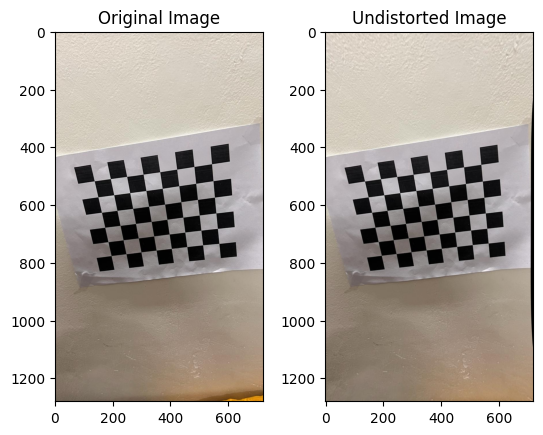

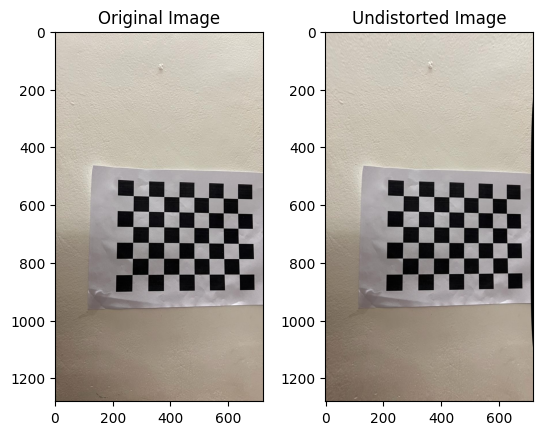

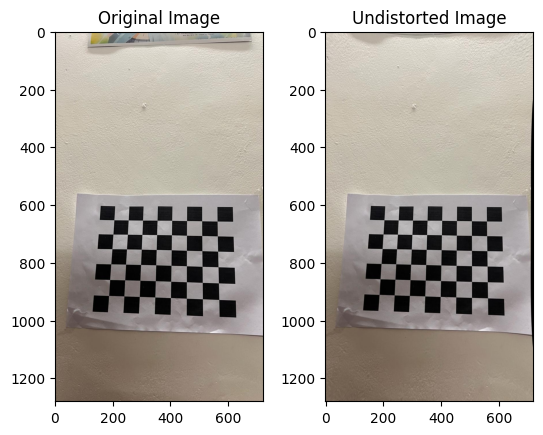

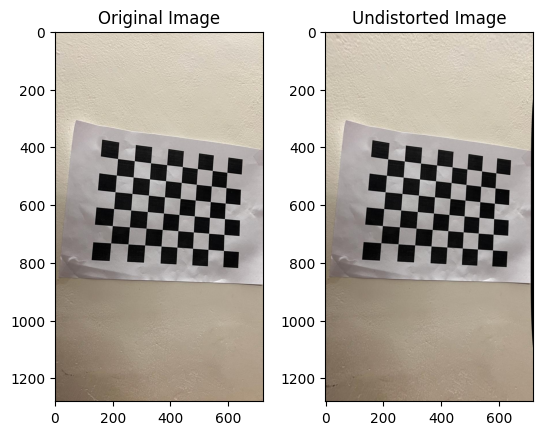

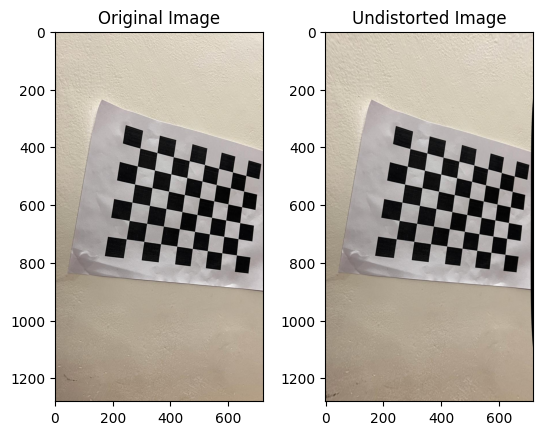

In [41]:
i = 0
while i < 5:
    img = cv2.imread(image_names[i])
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    
    fig, (ax1, ax2) = plt.subplots(1, 2)
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Image')
    ax2.imshow(cv2.cvtColor(dst, cv2.COLOR_BGR2RGB))
    ax2.set_title('Undistorted Image')
    
    plt.show()
    i += 1

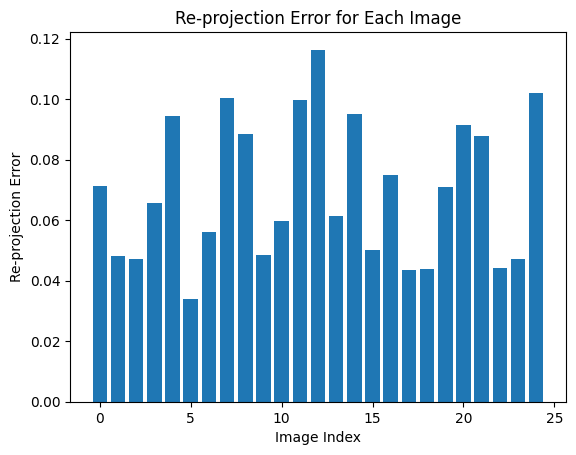

Mean re-projection error: 0.06971439945721061
Standard deviation of re-projection error: 0.023213790898823205


In [42]:
reprojection_errors = []

i = 0
while i < len(objpoints):
    img = cv2.imread(image_names[i])
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    imgpoints2, _ = cv2.projectPoints(objpoints[i], rvecs[i], tvecs[i], mtx, dist)
    imgpoints2 = imgpoints2.reshape(-1, 2)

    # Convert imgpoints to the same data type as imgpoints2
    imgpoints[i] = np.array(imgpoints[i]).reshape(-1, 2)

    error = cv2.norm(imgpoints[i], imgpoints2, cv2.NORM_L2) / len(imgpoints2)
    reprojection_errors.append(error)
    
    i += 1

q=len(reprojection_errors)
plt.bar(range(q), reprojection_errors)
plt.xlabel('Image Index')
plt.ylabel('Re-projection Error')
plt.title('Re-projection Error for Each Image')
plt.show()

mean=np.mean(reprojection_errors)
mean_error = mean
std_error = np.std(reprojection_errors)
std=std_error
print(f"Mean re-projection error: {mean}")
print(f"Standard deviation of re-projection error: {std_error}")

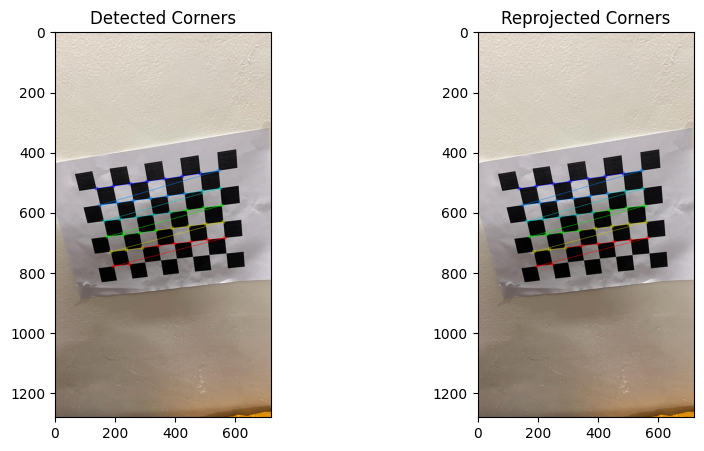

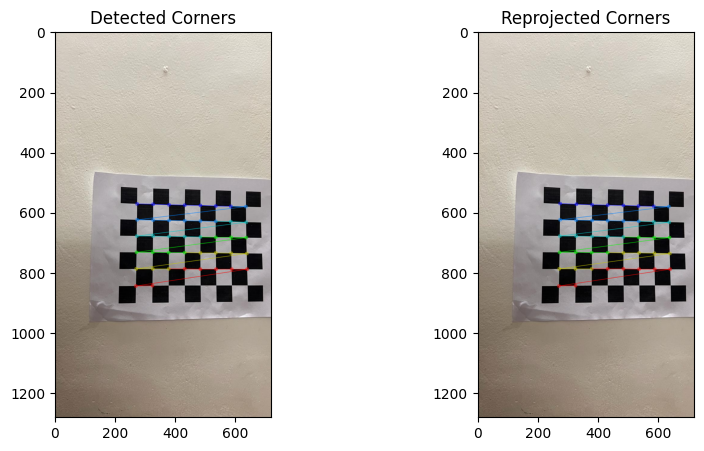

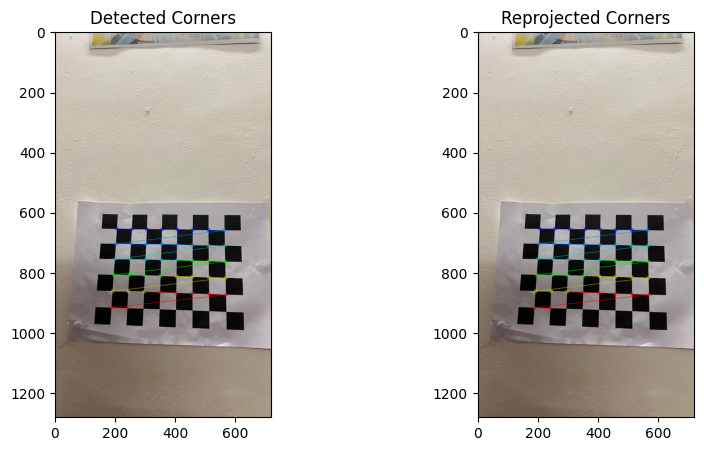

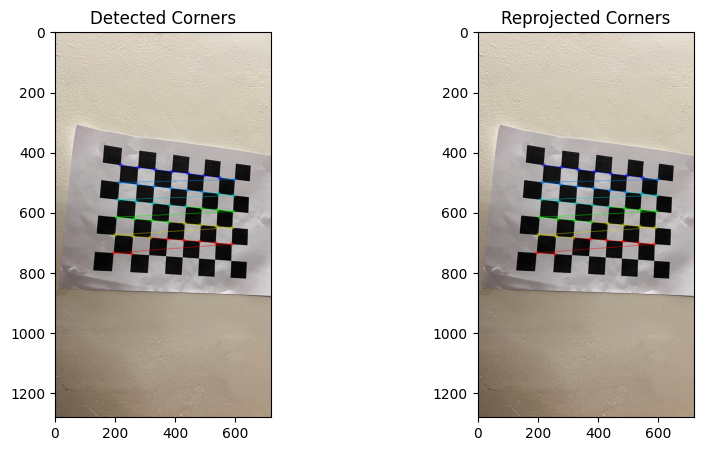

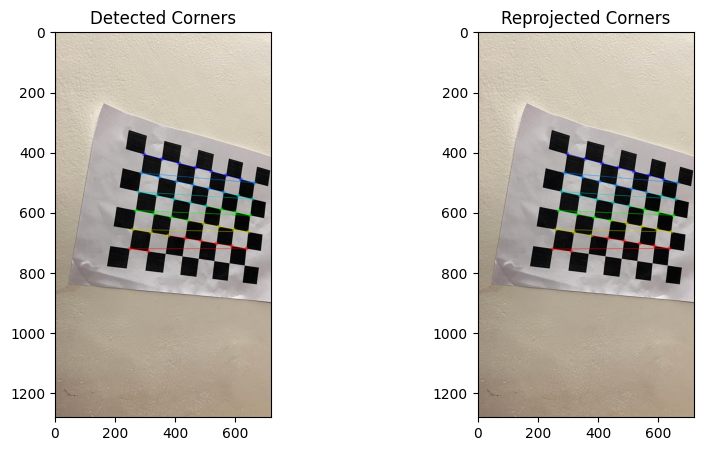

...

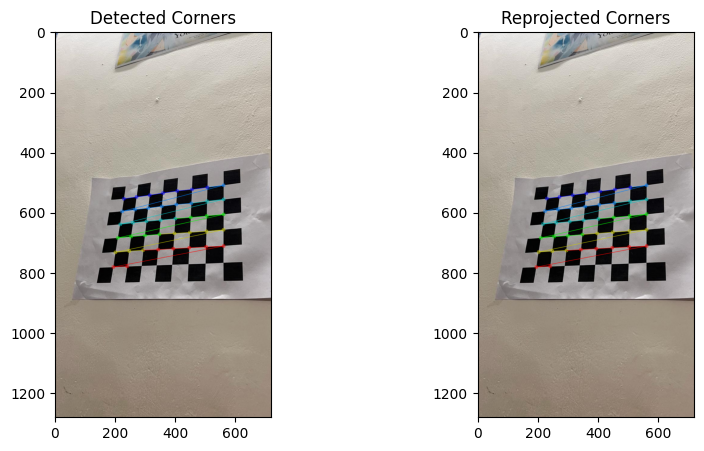

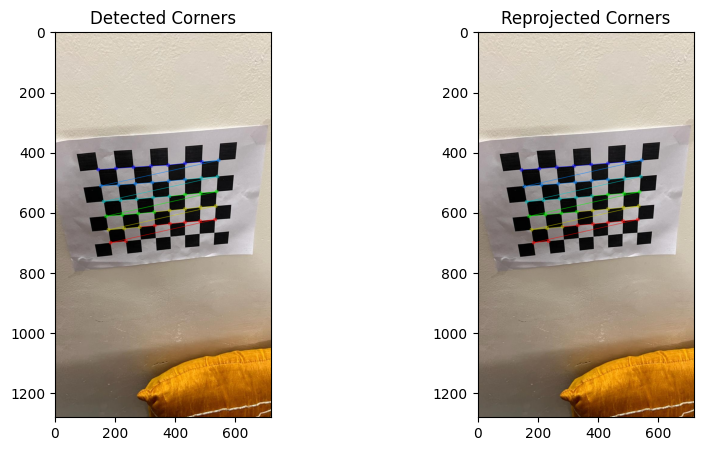

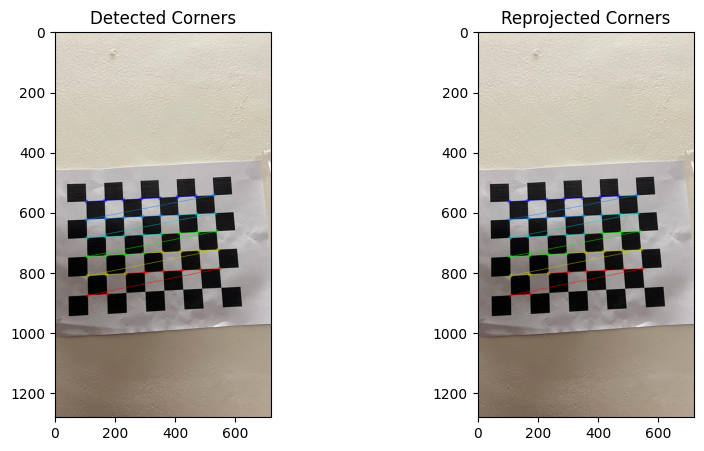

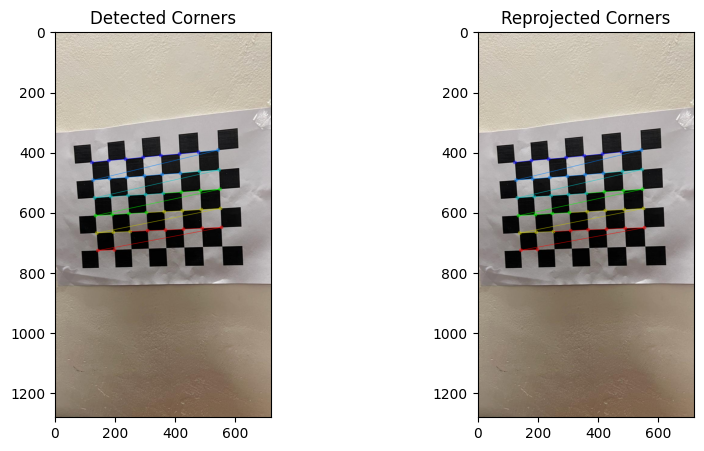

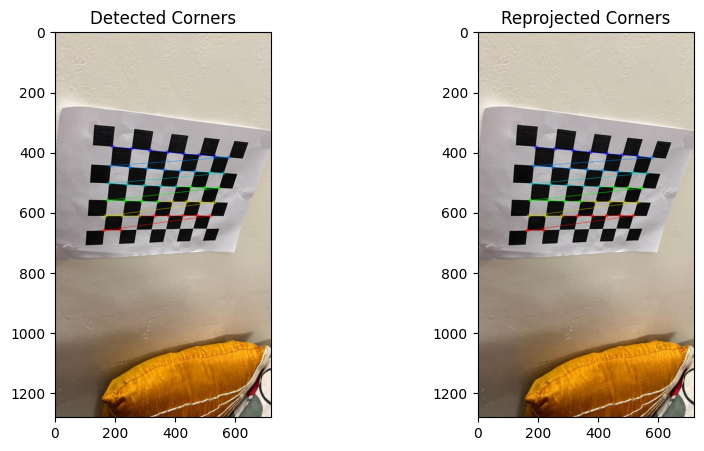

In [43]:
i = 0
while i < len(objpoints):
    img = cv2.imread(image_names[i])
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert to RGB for matplotlib

    img_detected = cv2.drawChessboardCorners(img.copy(), (7, 6), imgpoints[i], True)

    imgpoints2, _ = cv2.projectPoints(objpoints[i], rvecs[i], tvecs[i], mtx, dist)
    imgpoints2 = imgpoints2.reshape(-1, 2)
    img_reprojected = cv2.drawChessboardCorners(img.copy(), (7, 6), imgpoints2, True)

    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(img_detected)
    plt.title('Detected Corners')
    plt.subplot(1, 2, 2)
    plt.imshow(img_reprojected)
    plt.title('Reprojected Corners')
    plt.show()

    i += 1


In [44]:
i = 0
while i < len(objpoints):
    rotation_matrix, _ = cv2.Rodrigues(rvecs[i])
    normal = rotation_matrix[:, 2]

    print(f'{image_names[i]}:')
    print(f'Plane Normal: {normal}')
    i += 1


/kaggle/input/chess-board/chessboard_dataset-20250402T180104Z-001/chessboard_dataset/14.jpeg:
Plane Normal: [ 0.04521854 -0.32517343  0.94457267]
/kaggle/input/chess-board/chessboard_dataset-20250402T180104Z-001/chessboard_dataset/18.jpeg:
Plane Normal: [-0.14608072  0.07386587  0.98651115]
/kaggle/input/chess-board/chessboard_dataset-20250402T180104Z-001/chessboard_dataset/16.jpeg:
Plane Normal: [0.07201336 0.21723429 0.97345947]
/kaggle/input/chess-board/chessboard_dataset-20250402T180104Z-001/chessboard_dataset/25.jpeg:
Plane Normal: [-0.22325172  0.06830378  0.97236478]
/kaggle/input/chess-board/chessboard_dataset-20250402T180104Z-001/chessboard_dataset/22.jpeg:
Plane Normal: [-0.36034965  0.0181408   0.9326409 ]
/kaggle/input/chess-board/chessboard_dataset-20250402T180104Z-001/chessboard_dataset/24.jpeg:
Plane Normal: [ 0.0356678  -0.11054531  0.99323086]
/kaggle/input/chess-board/chessboard_dataset-20250402T180104Z-001/chessboard_dataset/6.jpeg:
Plane Normal: [-0.08327302 -0.1275

In [45]:
print(k)

[[ 0.19763718 -0.70686979  0.00336936  0.00698242  0.04879612]]


In [46]:

print(tvex1)  
print(tvex2)  

tvex2[2][0]

[[-3.93829473]
 [-3.61716296]
 [14.65911195]]
[[-1.49771589]
 [-0.657919  ]
 [13.91817088]]


13.918170880592848

In [47]:
json_res = {
    "intrinsic_parameters": {
        "focal_length": [
            fx,
            fy
        ],
        "skew": s,
        "principal_point": [
            cx,
            cy
        ]
    },
    "extrinsic_parameters": [
        {
            "image_id": 1,
            "rotation_matrix": rotation_matrix1.tolist(),
            "translation_vector": [
                tvex1[0][0],
                tvex1[1][0],
                tvex1[2][0]
            ]
        },
        {
            "image_id": 2,
            "rotation_matrix": rotation_matrix2.tolist() ,
            "translation_vector":  [
                tvex2[0][0],
                tvex2[1][0],
                tvex2[2][0]
            ]
        }
    ],
    "radial_distortion_coefficients": [
        k[0][0],
        k[0][1],
        k[0][4]
    ],
    "reprojection_errors": {
        "mean_error": mean_error,
        "std_dev": std
    }
}

# Saving the JSON to a file
json_file_path = "/kaggle/working/calibration_results.json"
with open(json_file_path, 'w') as json_file:
    json.dump(json_res, json_file, indent=4)

print(f"Calibration results saved to {json_file_path}")

Calibration results saved to /kaggle/working/calibration_results.json


In [48]:
print(image_names)

['/kaggle/input/chess-board/chessboard_dataset-20250402T180104Z-001/chessboard_dataset/14.jpeg', '/kaggle/input/chess-board/chessboard_dataset-20250402T180104Z-001/chessboard_dataset/18.jpeg', '/kaggle/input/chess-board/chessboard_dataset-20250402T180104Z-001/chessboard_dataset/16.jpeg', '/kaggle/input/chess-board/chessboard_dataset-20250402T180104Z-001/chessboard_dataset/25.jpeg', '/kaggle/input/chess-board/chessboard_dataset-20250402T180104Z-001/chessboard_dataset/22.jpeg', '/kaggle/input/chess-board/chessboard_dataset-20250402T180104Z-001/chessboard_dataset/24.jpeg', '/kaggle/input/chess-board/chessboard_dataset-20250402T180104Z-001/chessboard_dataset/6.jpeg', '/kaggle/input/chess-board/chessboard_dataset-20250402T180104Z-001/chessboard_dataset/9.jpeg', '/kaggle/input/chess-board/chessboard_dataset-20250402T180104Z-001/chessboard_dataset/11.jpeg', '/kaggle/input/chess-board/chessboard_dataset-20250402T180104Z-001/chessboard_dataset/20.jpeg', '/kaggle/input/chess-board/chessboard_dat

**MY DATASET**

/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0047.jpg


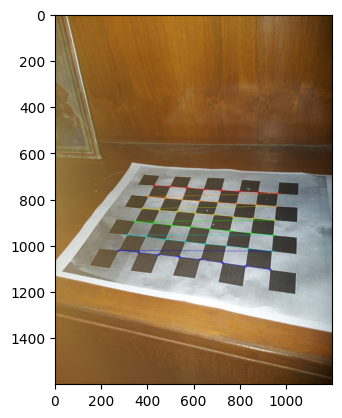

/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0067.jpg


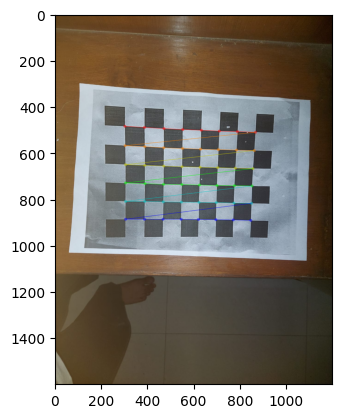

/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0061.jpg


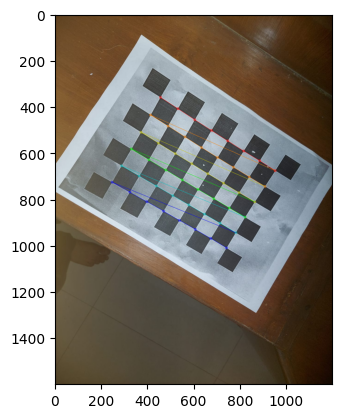

/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0046.jpg


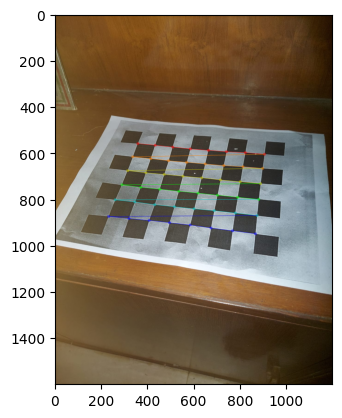

/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0043.jpg


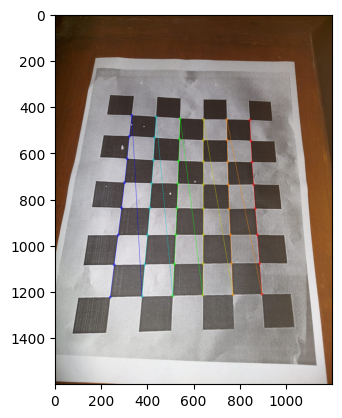

/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0050.jpg


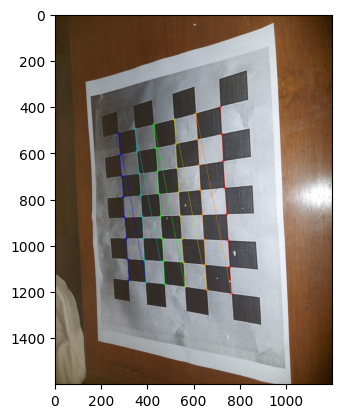

/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0073.jpg


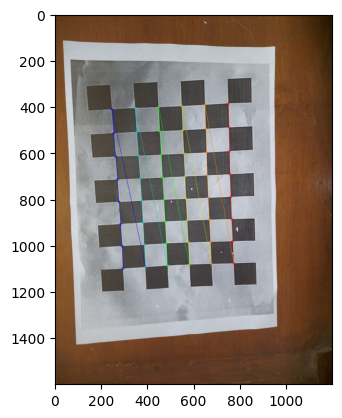

/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0063.jpg


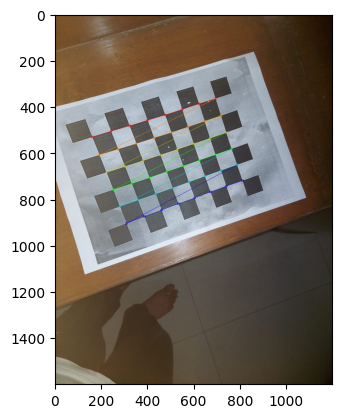

/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0045.jpg


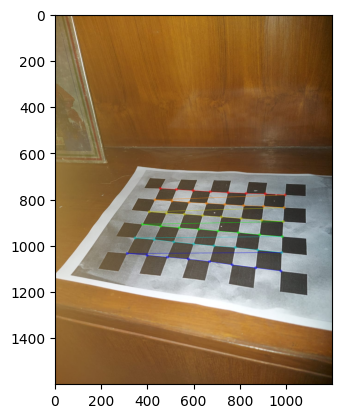

/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0044.jpg


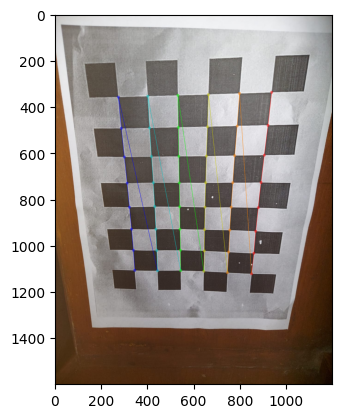

/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0069.jpg


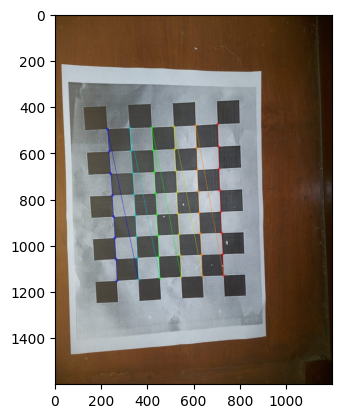

/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0041.jpg


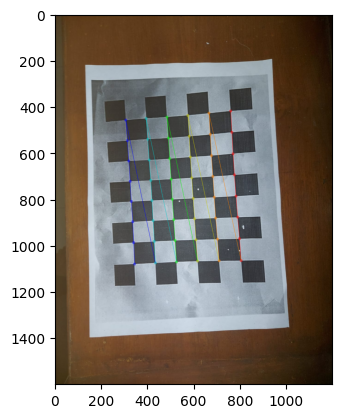

/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0051.jpg
Corners not found in image /kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0051.jpg. Skipping.
/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0048.jpg
Corners not found in image /kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0048.jpg. Skipping.
/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0058.jpg
Corners not found in image /kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0058.jpg. Skipping.
/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0049.jpg


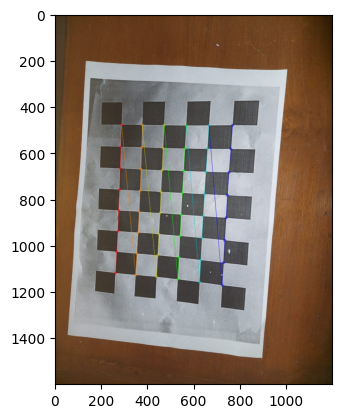

/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0064.jpg


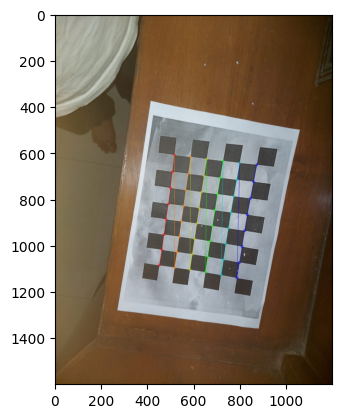

/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0062.jpg
Corners not found in image /kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0062.jpg. Skipping.
/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0059.jpg


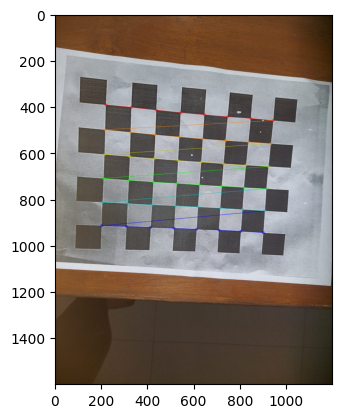

/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0057.jpg


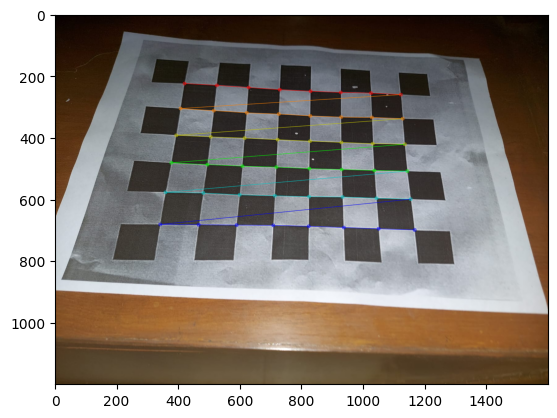

/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0068.jpg


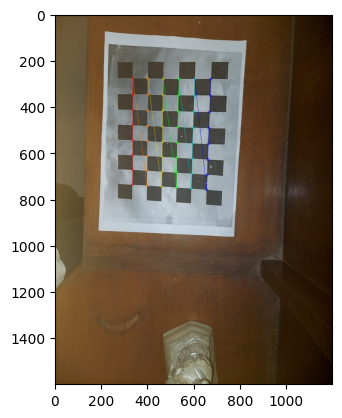

/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0052.jpg


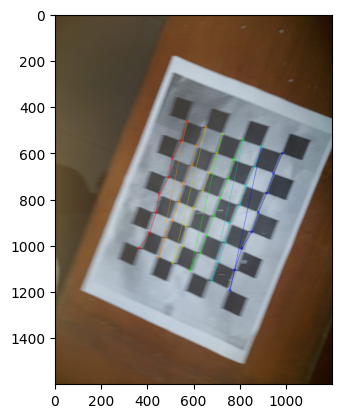

/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0060.jpg


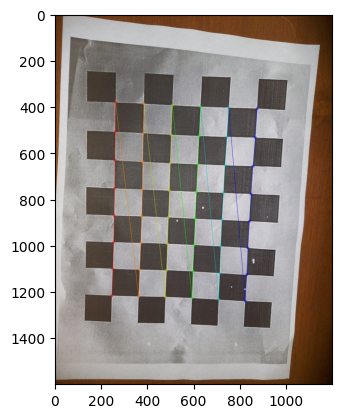

/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0055.jpg


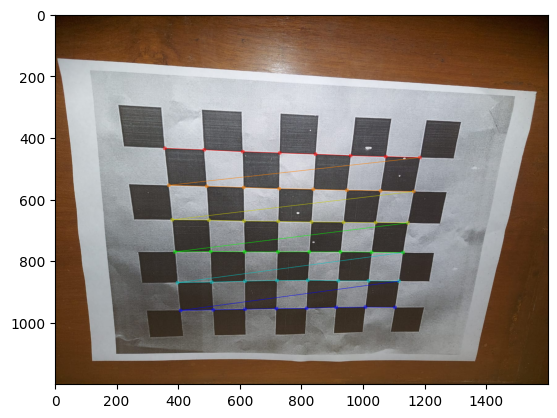

/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0054.jpg
Corners not found in image /kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0054.jpg. Skipping.
/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0071.jpg
Corners not found in image /kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0071.jpg. Skipping.
/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0066.jpg


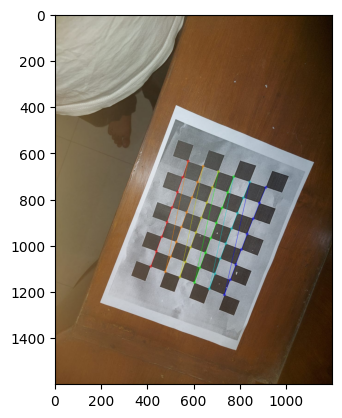

/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0056.jpg


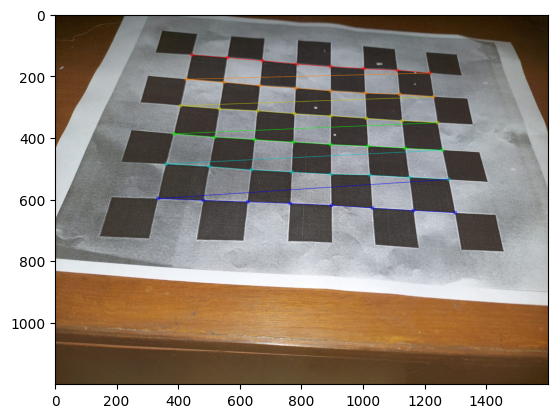

/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0053.jpg


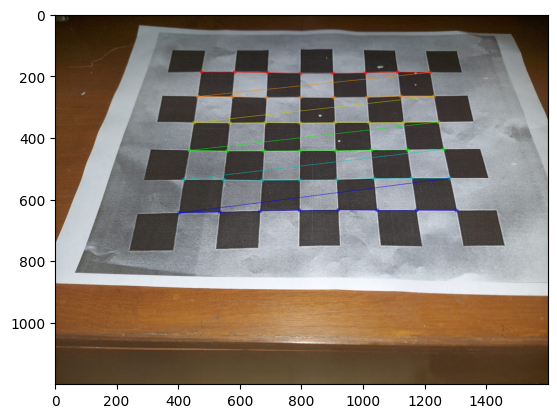

In [49]:
import numpy as np
import matplotlib.pyplot as plt
import os
import cv2

DIR_PATH = r"/kaggle/input/chess-board/Dataset2/Dataset2"

image_names = []
my_cnt = 0
for name in os.listdir(DIR_PATH):
    if name.lower().endswith(('.png', '.jpg', '.jpeg')):
        image_names.append(os.path.join(DIR_PATH, name))

criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)

objp = np.zeros((8 * 6, 3), np.float32)
objp[:, :2] = np.mgrid[0:8, 0:6].T.reshape(-1, 2)

alpha = 0

objpoints = []  
imgpoints = [] 

for image_name in image_names:
    if image_name == "/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0042.jpg" or \
       image_name == "/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0070.jpg" or \
       image_name == "/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0065.jpg":
        continue
    if image_name == "/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0072.jpg":
        continue

    print(image_name)
    img = cv2.imread(image_name)

    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    ret, corners = cv2.findChessboardCorners(gray, (8, 6), None)
    my_cnt += 1

    # Check if corners were found
    if ret:
        objpoints.append(objp)
        corners2 = cv2.cornerSubPix(gray, corners, (11, 11), (-1, -1), criteria)
        imgpoints.append(corners2)

        img = cv2.drawChessboardCorners(img, (8, 6), corners2, ret)
        my_cnt += 1
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.show()
    else:
        print(f"Corners not found in image {image_name}. Skipping.")

cv2.destroyAllWindows()

# After collecting the object points and image points, proceed with calibration
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)



In [50]:
fx = mtx[0, 0]
fy = mtx[1, 1]
cx = mtx[0, 2]
ax = mtx[2, 0]
cy = mtx[1, 2]
s =  mtx[0, 1]
qx=mtx[2,2]
print("Camera matrix : \n")
print(mtx)
print("fx = ", fx)
print("fy = ", fy)
print("cx = ", cx)
print("cy = ", cy)
print("s = ", s)

Camera matrix : 

[[1.21639845e+03 0.00000000e+00 7.61817209e+02]
 [0.00000000e+00 1.19963824e+03 8.67839611e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
fx =  1216.3984514424942
fy =  1199.638241083678
cx =  761.8172089419866
cy =  867.8396114071278
s =  0.0


In [51]:
print(len(objpoints))

23


In [52]:
for i in range(len(objpoints)):
    rotation_matrix, _ = cv2.Rodrigues(rvecs[i])
    print(f'{image_names[i]}:')
    print('Rotation Matrix:')
    print(rotation_matrix)
    print('Translation Vector:')
    print(tvecs[i])
    print()

/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0047.jpg:
Rotation Matrix:
[[ 0.98714341 -0.15765787  0.0263037 ]
 [ 0.09021286  0.68540136  0.72255562]
 [-0.13194517 -0.71089308  0.6908122 ]]
Translation Vector:
[[-4.5190862 ]
 [-1.75351834]
 [16.37255545]]

/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0067.jpg:
Rotation Matrix:
[[ 0.98529399 -0.03981172 -0.16616492]
 [ 0.0118804   0.98608586 -0.16581171]
 [ 0.17045413  0.16139918  0.97205745]]
Translation Vector:
[[-5.6143123]
 [-4.7051748]
 [14.3411761]]

/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0042.jpg:
Rotation Matrix:
[[ 0.84157687 -0.52873861 -0.11038055]
 [ 0.50286262  0.8415644  -0.19722716]
 [ 0.19717395  0.11047556  0.97412401]]
Translation Vector:
[[-3.56682633]
 [-5.9209545 ]
 [13.69757745]]

/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0061.jpg:
Rotation Matrix:
[[ 0.99284299 -0.116493   -0.02630916]
 [ 0.11239868  0.83700175  0.53553208]
 [-0.04036493 -0.53465639 

In [53]:
k=dist
print(f'Distortion coefficients: {k}')

Distortion coefficients: [[-0.006025    0.18945388  0.01368964  0.02305314 -0.24908978]]


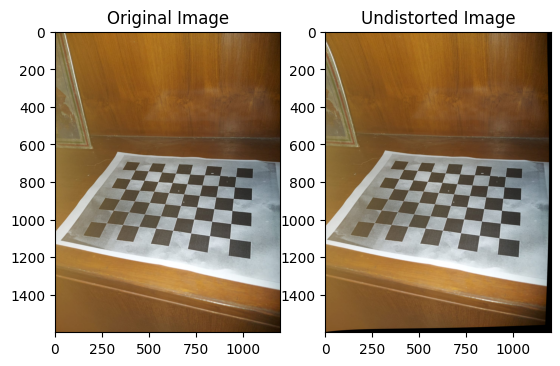

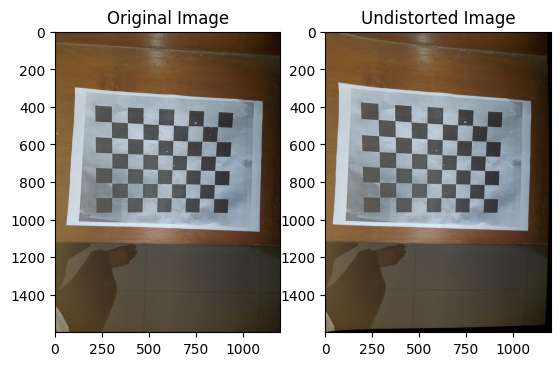

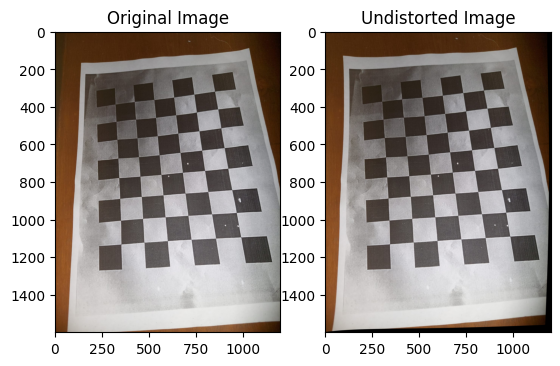

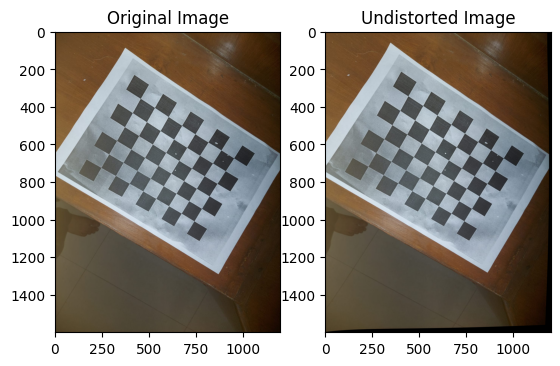

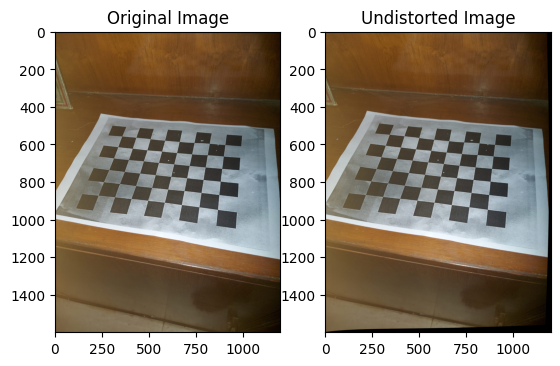

In [54]:
i = 0
while i < 5:
    img = cv2.imread(image_names[i])
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    
    fig, (ax1, ax2) = plt.subplots(1, 2)
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Image')
    ax2.imshow(cv2.cvtColor(dst, cv2.COLOR_BGR2RGB))
    ax2.set_title('Undistorted Image')
    
    plt.show()
    i += 1

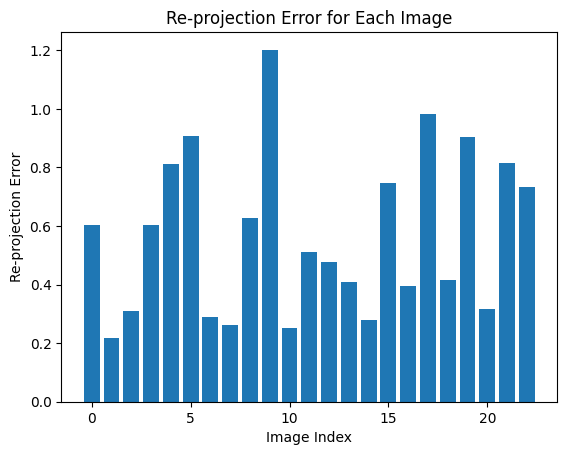

Mean re-projection error: 0.568172308867685
Standard deviation of re-projection error: 0.27048543856740676


In [55]:
reprojection_errors = []

i = 0
while i < len(objpoints):
    img = cv2.imread(image_names[i])
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    imgpoints2, _ = cv2.projectPoints(objpoints[i], rvecs[i], tvecs[i], mtx, dist)
    imgpoints2 = imgpoints2.reshape(-1, 2)

    # Convert imgpoints to the same data type as imgpoints2
    imgpoints[i] = np.array(imgpoints[i]).reshape(-1, 2)

    error = cv2.norm(imgpoints[i], imgpoints2, cv2.NORM_L2) / len(imgpoints2)
    reprojection_errors.append(error)
    
    i += 1

q=len(reprojection_errors)
plt.bar(range(q), reprojection_errors)
plt.xlabel('Image Index')
plt.ylabel('Re-projection Error')
plt.title('Re-projection Error for Each Image')
plt.show()

mean=np.mean(reprojection_errors)
mean_error = mean
std_error = np.std(reprojection_errors)
std=std_error
print(f"Mean re-projection error: {mean}")
print(f"Standard deviation of re-projection error: {std_error}")

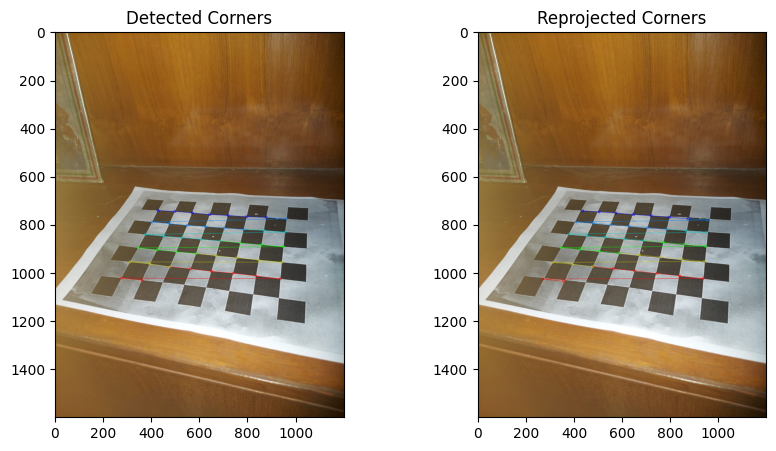

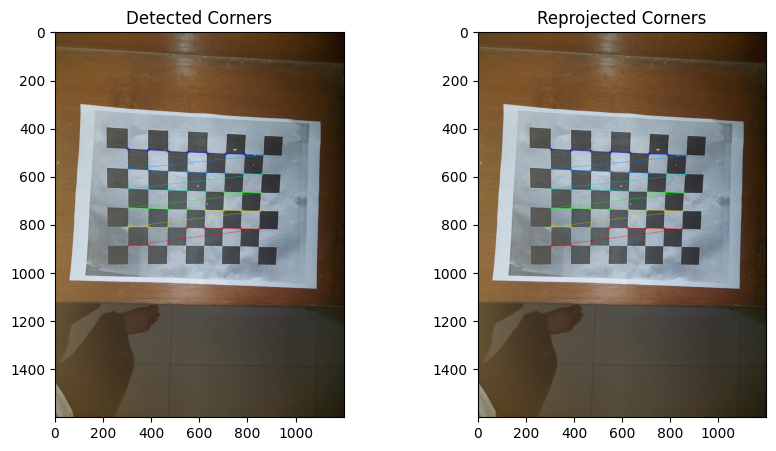

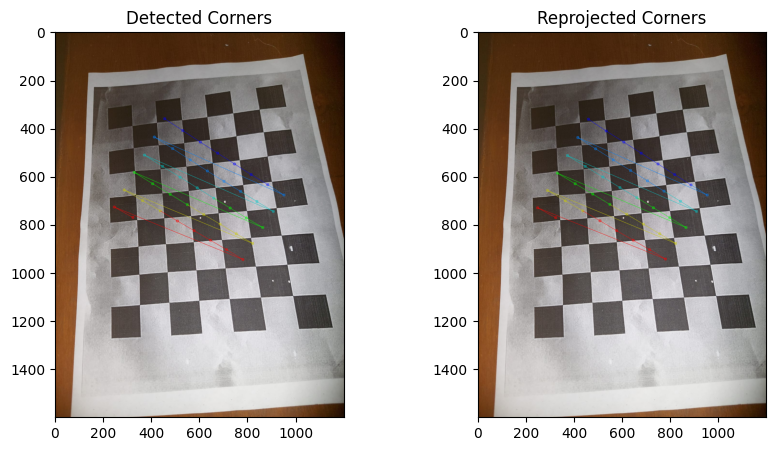

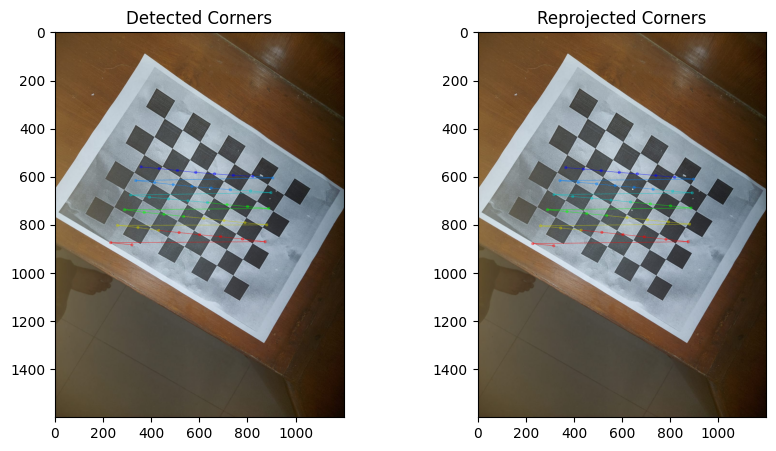

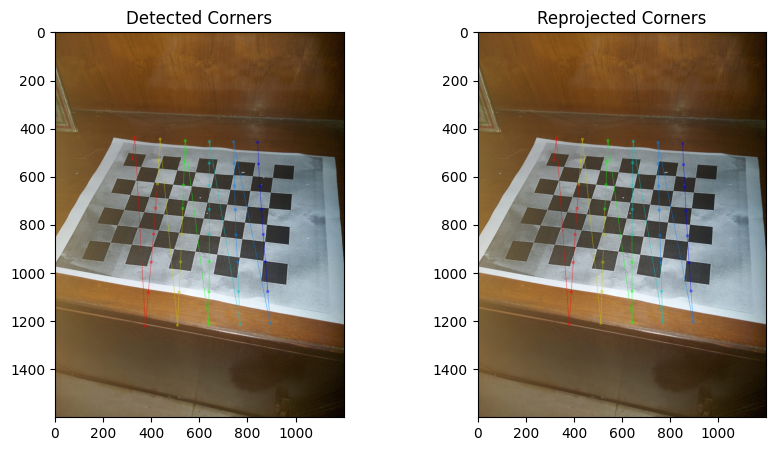

...

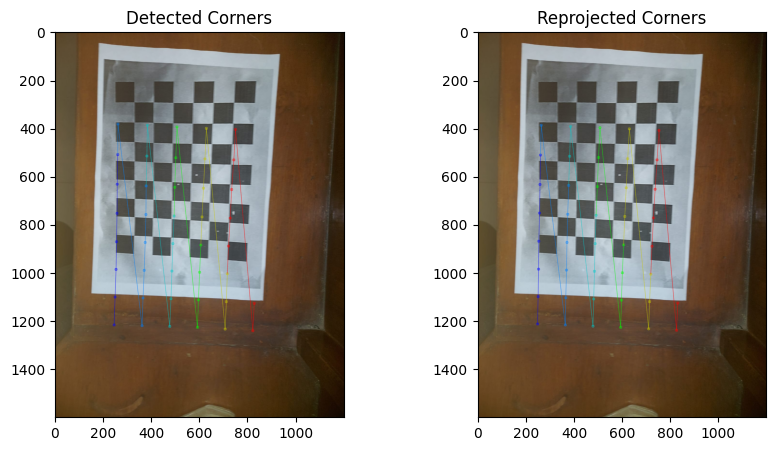

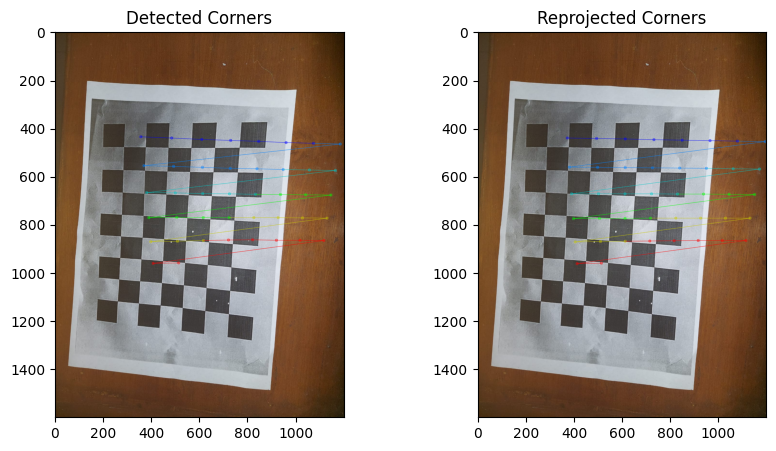

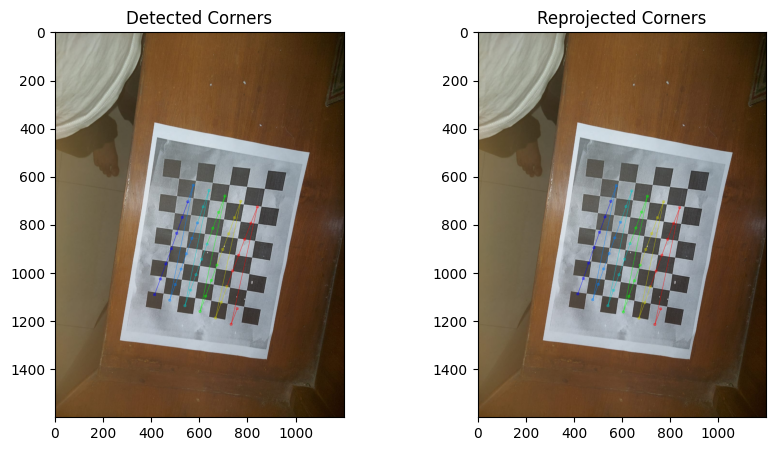

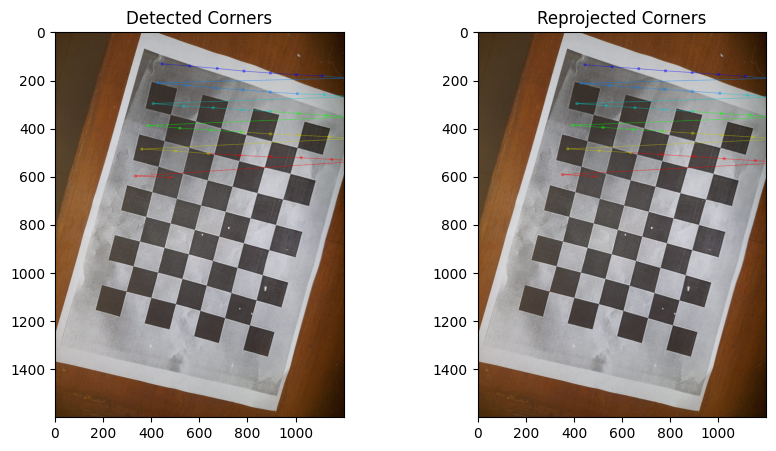

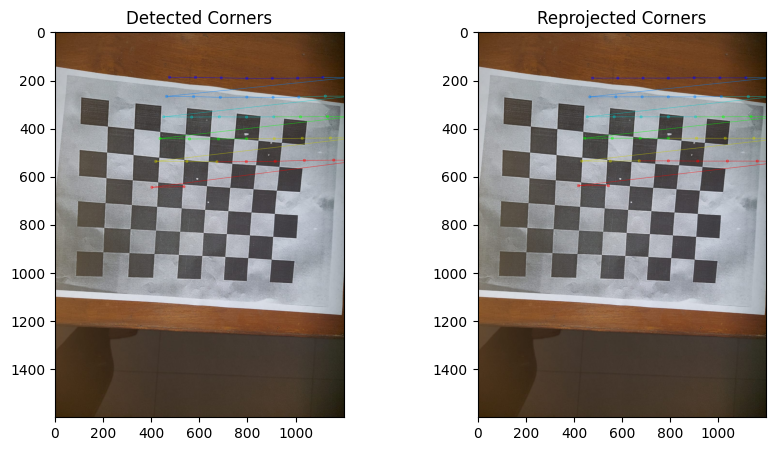

In [56]:
i = 0
while i < len(objpoints):
    img = cv2.imread(image_names[i])
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert to RGB for matplotlib

    img_detected = cv2.drawChessboardCorners(img.copy(), (7, 6), imgpoints[i], True)

    imgpoints2, _ = cv2.projectPoints(objpoints[i], rvecs[i], tvecs[i], mtx, dist)
    imgpoints2 = imgpoints2.reshape(-1, 2)
    img_reprojected = cv2.drawChessboardCorners(img.copy(), (7, 6), imgpoints2, True)

    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(img_detected)
    plt.title('Detected Corners')
    plt.subplot(1, 2, 2)
    plt.imshow(img_reprojected)
    plt.title('Reprojected Corners')
    plt.show()

    i += 1


In [57]:
i = 0
while i < len(objpoints):
    rotation_matrix, _ = cv2.Rodrigues(rvecs[i])
    normal = rotation_matrix[:, 2]

    print(f'{image_names[i]}:')
    print(f'Plane Normal: {normal}')
    i += 1


/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0047.jpg:
Plane Normal: [0.0263037  0.72255562 0.6908122 ]
/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0067.jpg:
Plane Normal: [-0.16616492 -0.16581171  0.97205745]
/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0042.jpg:
Plane Normal: [-0.11038055 -0.19722716  0.97412401]
/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0061.jpg:
Plane Normal: [-0.02630916  0.53553208  0.84410498]
/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0046.jpg:
Plane Normal: [-0.13324063  0.29406317  0.94645327]
/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0070.jpg:
Plane Normal: [ 0.3695629  -0.08272866  0.92551566]
/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0043.jpg:
Plane Normal: [-0.02164137 -0.12354672  0.99210275]
/kaggle/input/chess-board/Dataset2/Dataset2/IMG-20250404-WA0050.jpg:
Plane Normal: [-0.23631129 -0.09835753  0.96668649]
/kaggle/input/chess-board/Dataset2/